# Network growth models pt 1

In [1]:
# Load some packages
import numpy as np
import matplotlib.pyplot as plt
import random
import operator
from mpl_toolkits.mplot3d import Axes3D

In [2]:
def rich_get_richer(n0 = 20, n = 60):
    np.random.seed(16894)
        
    # generate the nodes positions in [0,1)x[0,1)
    x = np.random.rand(n0) # random array, elements in [0,1), length n
    y = np.random.rand(n0) # same....
    z = np.random.rand(n0)

    # connectivity should be such that all vertices are connected
    conn = np.array([6, 18, 14,  5,  0, 16, 12,  1, 17, 19, 15,  2, 13, 11,  4,  9, 10,  7,  8,  3])
    conn_copy = conn
    #print(conn)
    
    fig = plt.figure(figsize=(10,8))
    ax = Axes3D(fig)
    for j,k,l,i in zip(x,y,z,range(len(x))):
        ax.text(j,k,l,i)
        
    for i in range(len(x)):
        ax.plot([x[i],x[conn[i]]], [y[i],y[conn[i]]], [z[i],z[conn[i]]])
    ax.scatter3D(x, y, z,s=40, cmap='Greens');


    plt.show()  
    
    
    for i in range(n):
        # create a random node
        #while True:
        new_x= np.random.rand()
        new_y= np.random.rand()
        new_z= np.random.rand()

        while True:
            new_conn = np.random.choice(conn) # weighted choice (wrt to the degree of each node) among existing nodes
            if new_conn == np.argmax(conn==i): #if there is no "double edge", this is valid only for DIRECTED GRAPHS
                new_conn = np.random.choice(conn) 
            else:
                break
        
        x = np.append(x,new_x) #append the x coordinate of the new node
        y = np.append(y,new_y) #append the y coordinate of the new node
        z = np.append(z,new_z)
        conn = np.append(conn, new_conn) #append the existing node to which the new node will connect

        plt.clf()
        
        conn_2 = np.append(conn_copy,conn)
        conn_2 = conn_2.astype(int)
            
        fig = plt.figure(figsize=(10,8))
        ax = Axes3D(fig)
            
        for j,k,l,i in zip(x,y,z,range(len(x))):
            ax.text(j,k,l,i)
            
        for i in range(len(x)):
            ax.plot([x[i],x[conn_2[i]]], [y[i],y[conn_2[i]]], [z[i],z[conn_2[i]]])
        ax.scatter(x, y, z, s=40, cmap='hsv')


        plt.pause(0.001) # needed to force pyplot to actually show us
        

    deg = np.zeros(n0+n)
    for i in range(len(deg)):
        deg[i] +=1
        for j in range(len(conn_2)):
            if conn_2[j]==i:
                deg[i] +=1
                        
    index, value = max(enumerate(deg), key=operator.itemgetter(1))

    print(deg)
    print("Node with highest degree is:", index,"with a degree of:", value)

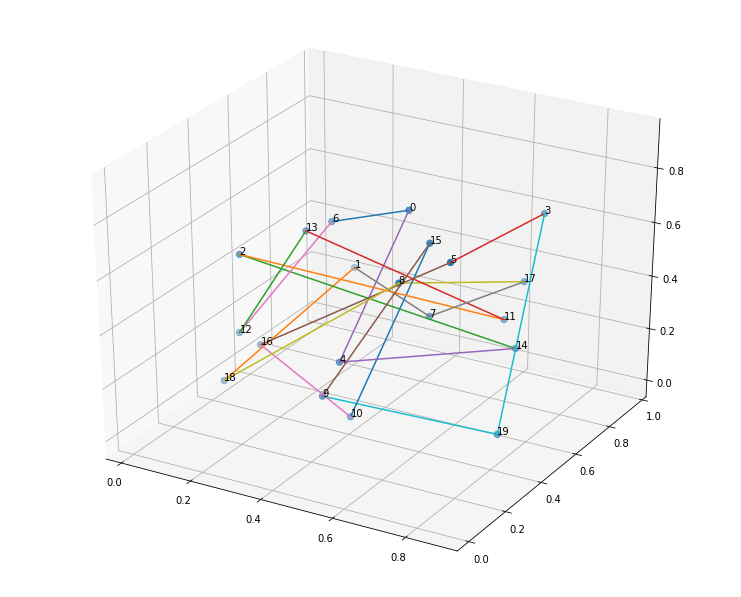

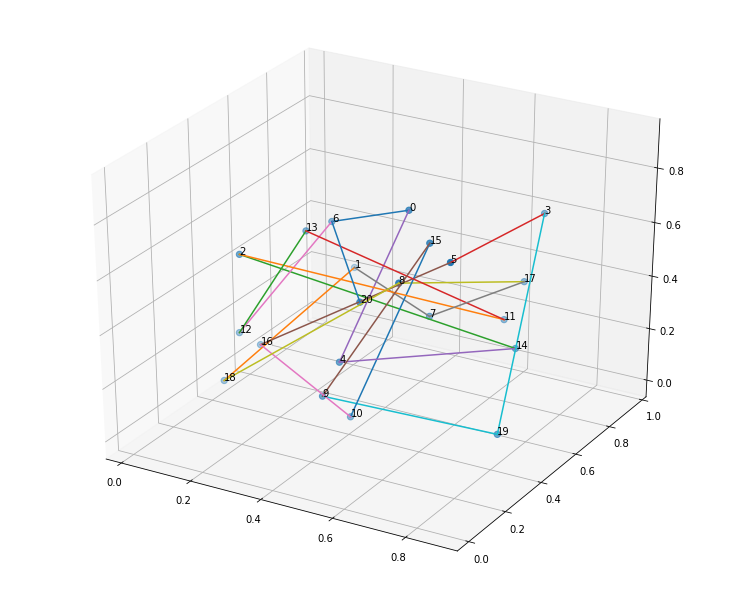

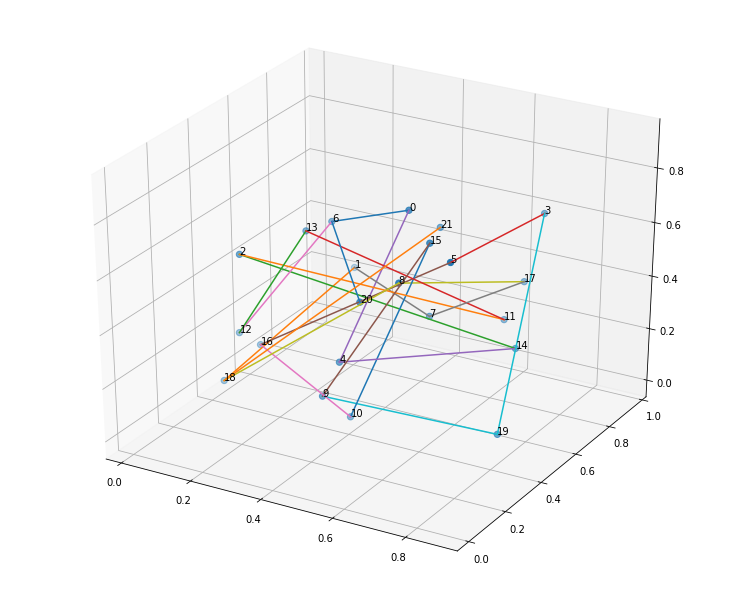

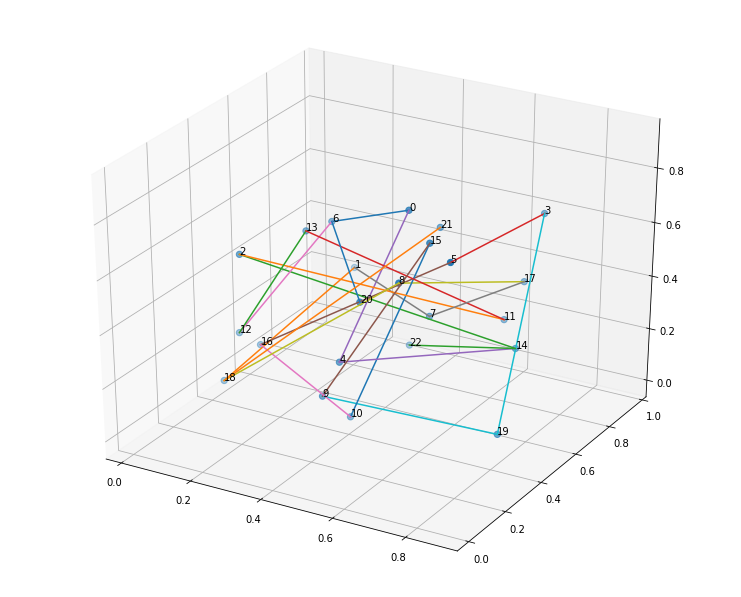

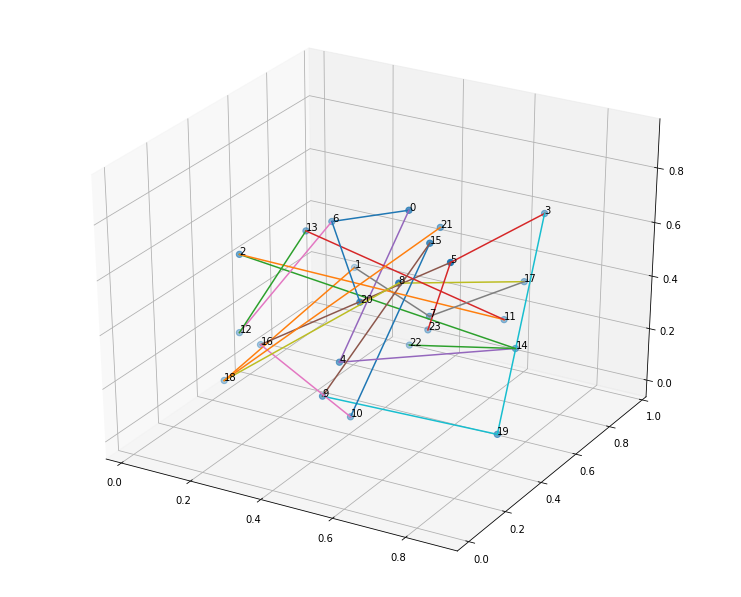

...

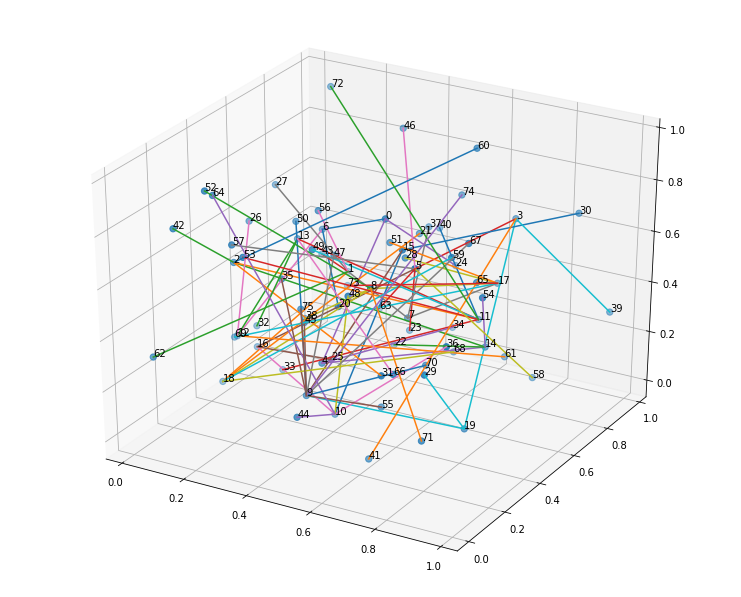

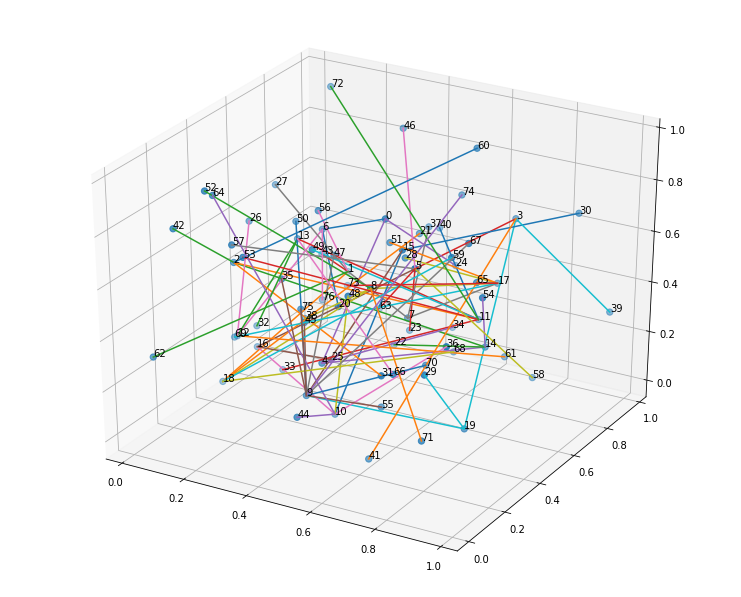

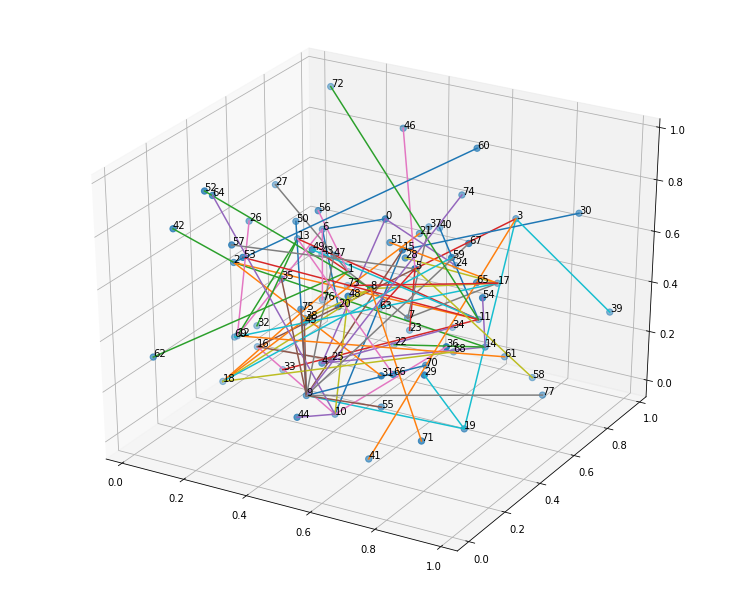

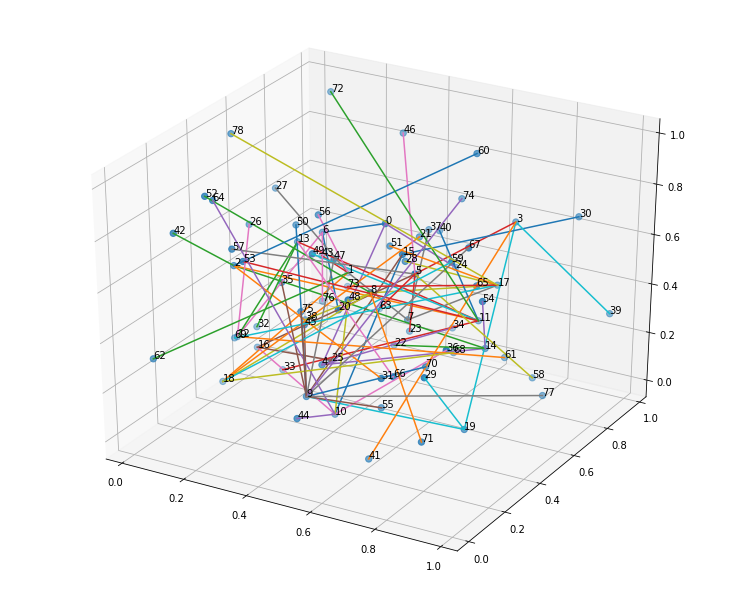

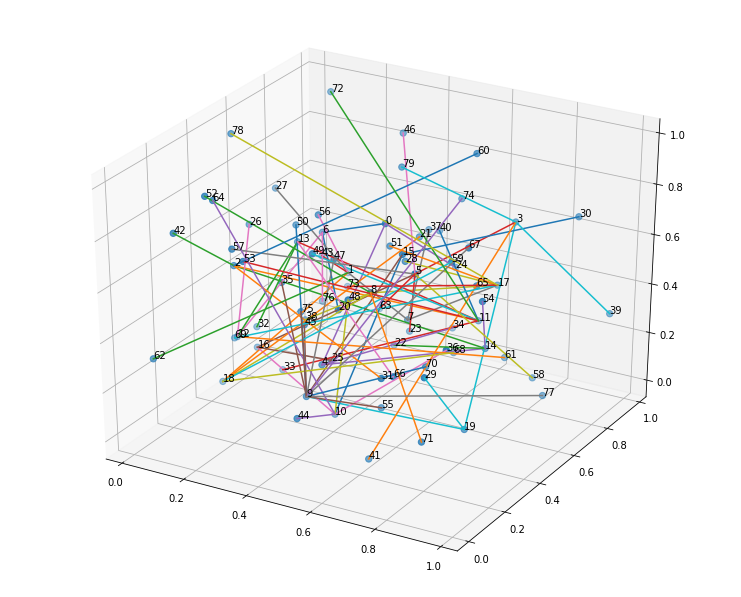

[  3.   6.   5.   7.   3.   8.   4.   3.   6.  14.   7.  10.   5.   5.   6.
   4.   3.  13.   5.   3.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.   1.
   1.   1.   1.   1.   1.]
Node with highest degree is: 9 with a degree of: 14.0


In [3]:
rich_get_richer()
#Problem: The new nodes (20,21, ... 35) are not connected
#Also, all nodes are not connected as they should be

In [4]:
def rand_net(n0 = 20, n = 60):
    np.random.seed(16894)
        
    # generate the nodes positions in [0,1)x[0,1)
    x = np.random.rand(n0) # random array, elements in [0,1), length n
    y = np.random.rand(n0) # same....
    z = np.random.rand(n0)

    # connectivity should be such that all vertices are connected
    conn = np.array([6, 18, 14,  5,  0, 16, 12,  1, 17, 19, 15,  2, 13, 11,  4,  9, 10,  7,  8,  3])
    conn_copy = conn
    #print(conn)
    
    fig = plt.figure(figsize=(10,8))
    ax = Axes3D(fig)
    
    for j,k,l,i in zip(x,y,z,range(len(x))):
        ax.text(j,k,l,i)
    
    for i in range(len(x)):
        ax.plot([x[i],x[conn[i]]], [y[i],y[conn[i]]], [z[i],z[conn[i]]])    
        ax.scatter3D(x, y, z, cmap='Greens');

    plt.show()  
    
    
    for i in range(n):
        # create a random node
        #while True:
        new_x= np.random.rand()
        new_y= np.random.rand()
        new_z= np.random.rand()

        while True:
            new_conn = random.choice(range(0, len(conn), 1))  # unweighted choice (wrt to the degree of each node) among existing nodes
            if not new_conn == np.argmax(conn==i): #if there is no "double edge", this is valid only for DIRECTED GRAPHS
                break

        x = np.append(x,new_x) #append the x coordinate of the new node
        y = np.append(y,new_y) #append the y coordinate of the new node
        z = np.append(z,new_z)
        conn = np.append(conn, new_conn) #append the existing node to which the new node will connect

        plt.clf()
        
        for t in range(len(x)):    
            conn_2 = np.append(conn_copy,conn)
            conn_2 = conn_2.astype(int)
            
        fig = plt.figure(figsize=(10,8))
        ax = Axes3D(fig)
            
        for j,k,l,i in zip(x,y,z,range(len(x))):
            ax.text(j,k,l,i)
            
        for i in range(len(x)):
            ax.plot([x[i],x[conn_2[i]]], [y[i],y[conn_2[i]]], [z[i],z[conn_2[i]]])
        ax.scatter(x, y, z, s=40, cmap='hsv')

        plt.pause(0.001) # needed to force pyplot to actually show us
        
            
    deg = np.zeros(n0+n)
    for i in range(len(deg)):
        deg[i] +=1
        for j in range(len(conn_2)):
            if conn_2[j]==i:
                deg[i] +=1
                
            
        index, value = max(enumerate(deg), key=operator.itemgetter(1))

    print(deg)
    print("Node with highest degree is:", index,"with a degree of:", value)

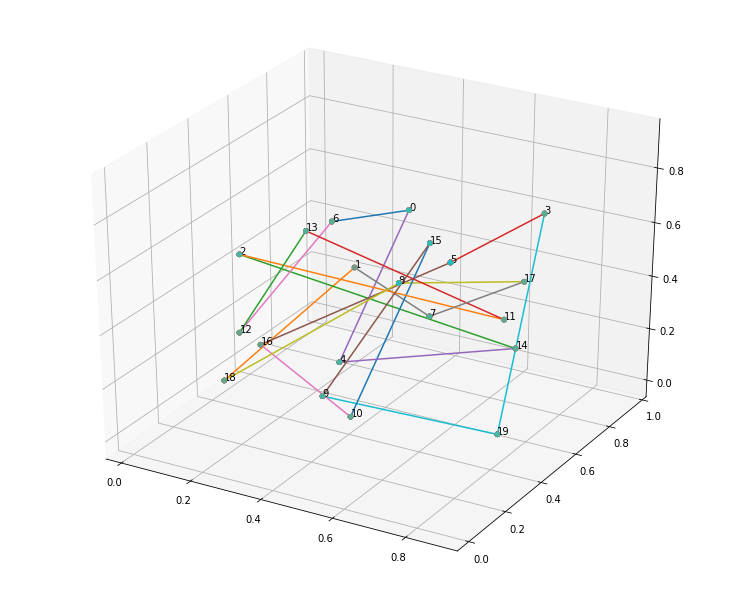

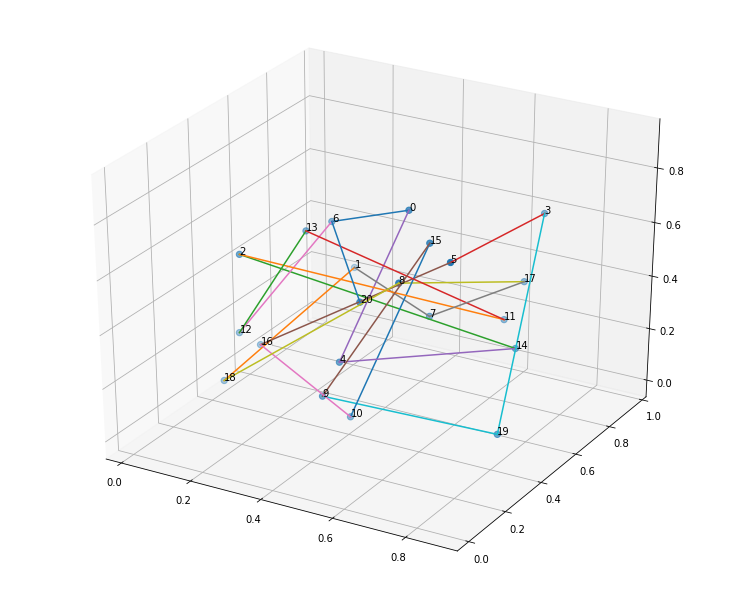

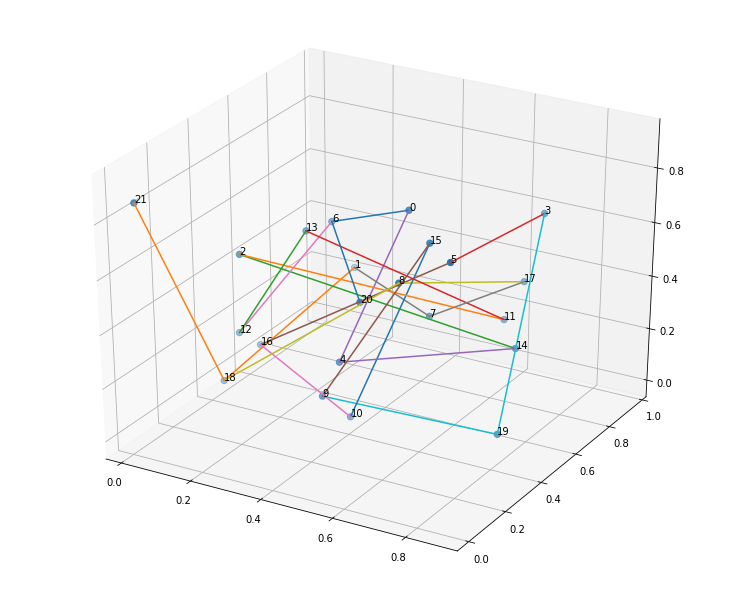

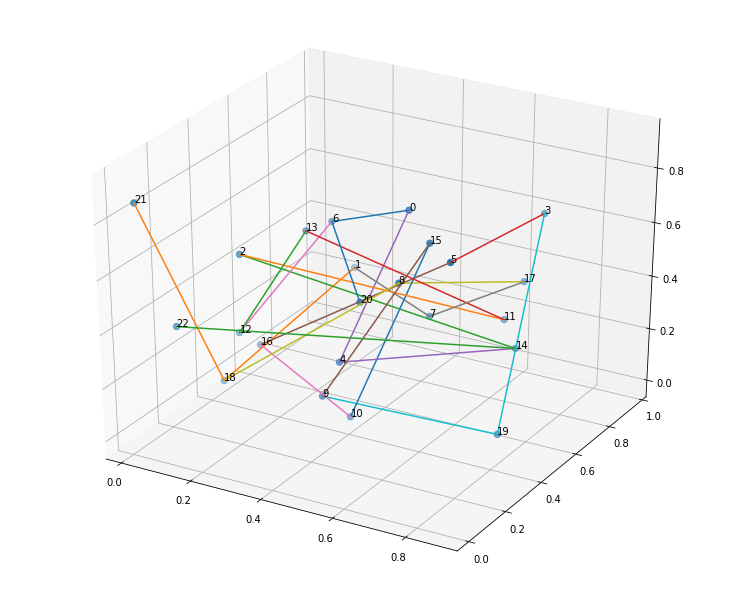

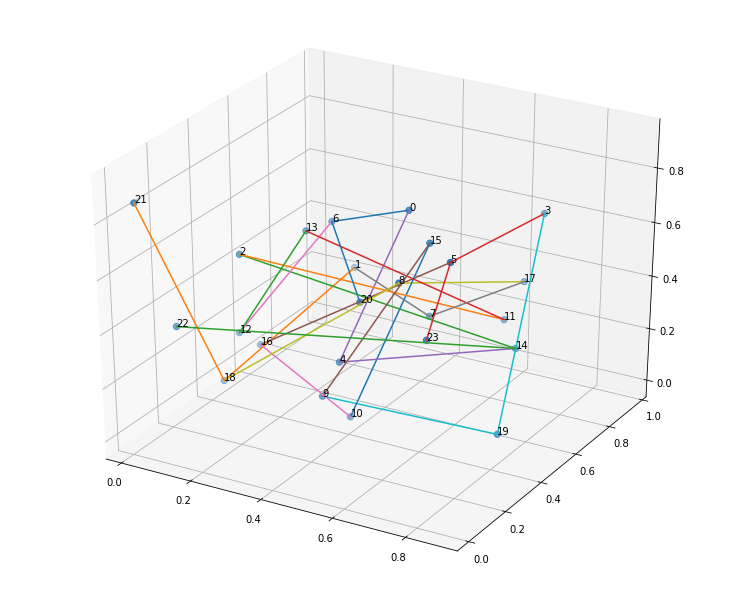

...

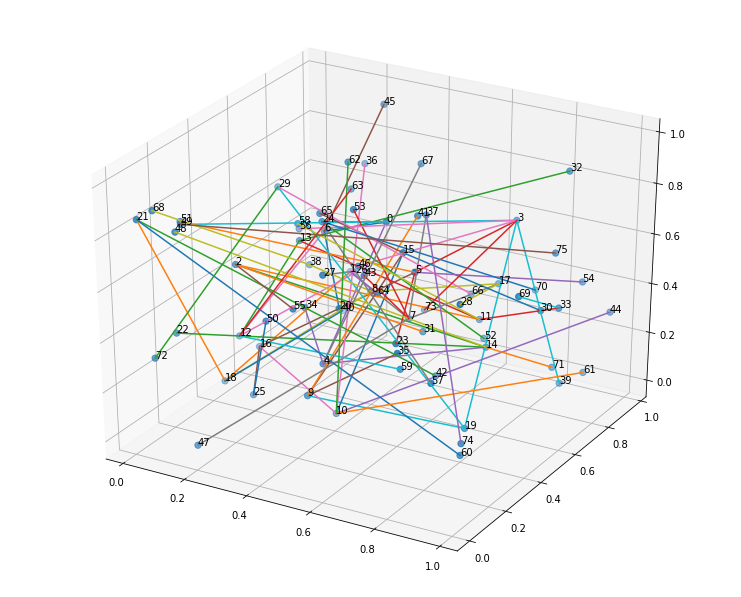

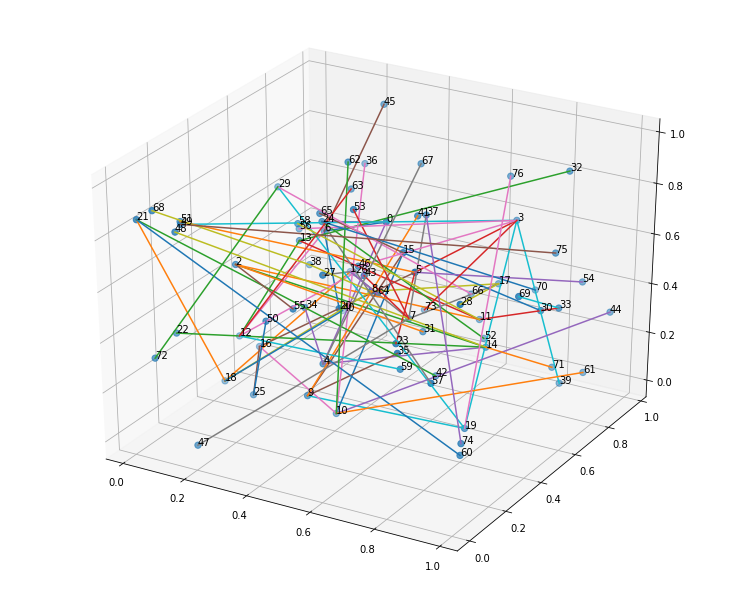

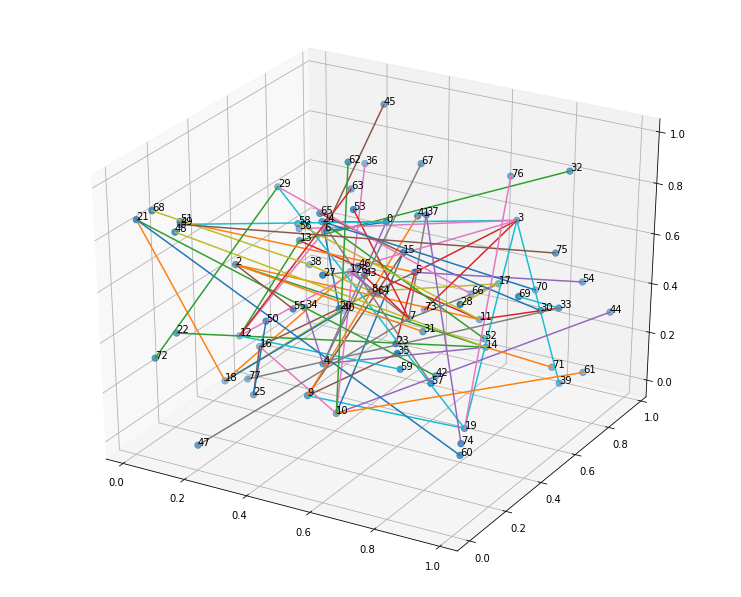

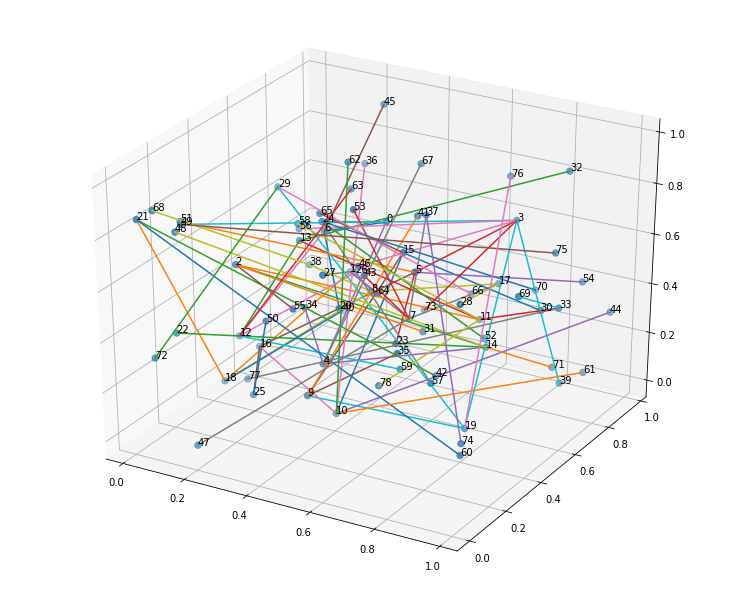

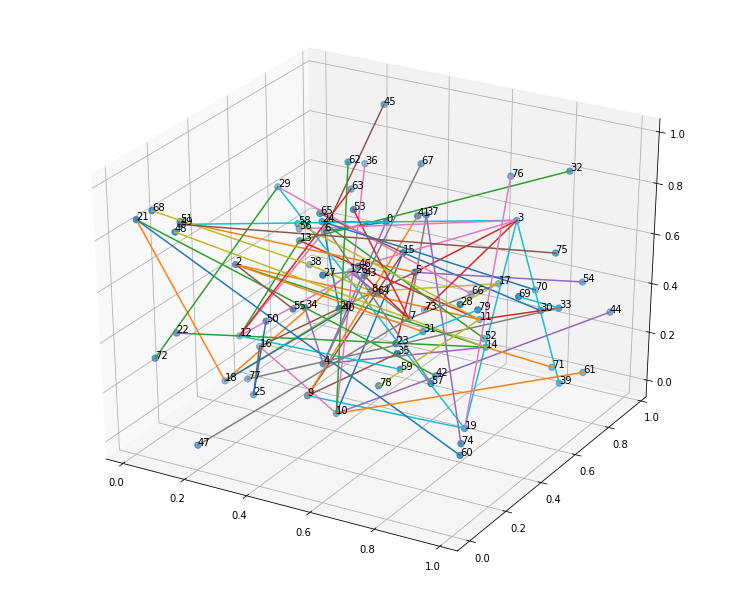

[ 3.  4.  4.  7.  4.  6.  4.  7.  3.  4.  7.  5.  5.  4.  6.  4.  3.  3.
  5.  4.  1.  3.  1.  2.  4.  2.  1.  2.  1.  3.  2.  2.  1.  3.  1.  1.
  1.  2.  2.  1.  1.  1.  1.  1.  1.  1.  1.  1.  2.  2.  1.  3.  1.  1.
  1.  3.  2.  2.  2.  2.  1.  1.  1.  1.  1.  1.  1.  1.  1.  2.  1.  1.
  2.  1.  1.  1.  1.  1.  1.  1.]
Node with highest degree is: 3 with a degree of: 7.0


In [5]:
rand_net()